<a href="https://colab.research.google.com/github/aaronc09/peds_lupus_flare_prediction_ML_gene-expression/blob/main/GSE135779_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install scanpy anndata

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import scanpy as sc

In [ ]:
!pip -q install scikit-misc


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 183.6/183.6 kB 6.6 MB/s eta 0:00:00


In [ ]:
pip install leidenalg


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 22.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.4/4.4 MB 49.3 MB/s eta 0:00:00


In [ ]:
!pip install scrublet anndata

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 647.5/647.5 kB 15.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for annoy: filename=annoy-1.17.3-cp312-cp312-linux_x86_64.whl size=551810 sha256=051657b5dda8162ef46ddb8d17147f6cf57da626f91a89b9490262315b53665b
  Stored in directory: /root/.cache/pip/wheels/db/b9/53/a3b2d1fe1743abadddec6aa541294b24fdbc39d7800bc57311
Successfully built annoy


In [ ]:
import subprocess
import sys

try:
    import igraph
    print("igraph is already installed.")
except ImportError:
    print("igraph not found. Installing with pip...")
    subprocess.check_call([sys.executable, "-m", "pip", "install", "igraph"])
    print("igraph installed successfully.")


igraph not found. Installing with pip...
igraph installed successfully.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

ROOT = "/content/drive/MyDrive/GSE135779/GSE135779_RAW"
HVG_DIR = os.path.join(ROOT, "hvg_h5ad")
print("HVG dir exists:", os.path.isdir(HVG_DIR))
print("Example files:", [f for f in os.listdir(HVG_DIR) if f.endswith(".h5ad")][:5])


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
HVG dir exists: True
Example files: ['GSM4029930_JB18077_hvg.h5ad', 'GSM4029917_JB18064_hvg.h5ad', 'GSM4029915_JB17018_hvg.h5ad', 'GSM4029898_JB17003_hvg.h5ad', 'GSM4029903_JB17008_hvg.h5ad']


In [ ]:
# === Per-sample gene-family filtering + QC (HVG files) ===
# Removes mitochondrial (MT-), ribosomal (RPS/RPL), and hemoglobin genes,
# then applies min_genes / max_counts / min_cells filters.

import os
import re
import numpy as np
import scanpy as sc

# -------- paths --------
input_folder  = "/content/drive/MyDrive/GSE135779/GSE135779_RAW/hvg_h5ad"
output_folder = "/content/drive/MyDrive/GSE135779/GSE135779_RAW/hvg_h5ad_geneQC"
os.makedirs(output_folder, exist_ok=True)

# -------- QC thresholds (tune if needed) --------
MIN_GENES_PER_CELL = 200
MAX_COUNTS_PER_CELL = 25000    # only meaningful if you have counts layer
MIN_CELLS_PER_GENE = 3

# -------- gene families to remove (symbols) --------
HB_SYMBOLS = {
    "HBA1","HBA2","HBB","HBD","HBG1","HBG2","HBZ","HBE1","HBM","HBQ1","HBQ2"
}
# (You can add RBC genes like "ALAS2", "AHSP" if your mentor wants those removed too.)

def get_gene_symbols(adata):
    """
    Return a pandas Series of gene symbols for adata.var, robustly.
    If 'gene_symbols' is present, use it; otherwise fall back to var_names.
    """
    if "gene_symbols" in adata.var.columns:
        syms = adata.var["gene_symbols"].astype(str)
    else:
        syms = adata.var_names.to_series().astype(str)
    return syms

def looks_like_ensembl(varnames: np.ndarray) -> bool:
    """Heuristic: do var_names look like Ensembl IDs (ENSG...)?"""
    if len(varnames) == 0:
        return False
    head = str(varnames[0])
    return bool(re.match(r"^ENSG\d+", head))

for filename in sorted(os.listdir(input_folder)):
    if not filename.endswith(".h5ad") or "all_samples" in filename:
        continue

    file_path = os.path.join(input_folder, filename)
    print(f"\n🧹 Processing {filename}")
    adata = sc.read_h5ad(file_path)
    n_cells0, n_genes0 = adata.shape

    # --- build gene symbol series (uppercase for matching) ---
    gene_syms = get_gene_symbols(adata).astype(str)
    gene_syms_uc = gene_syms.str.upper()

    # --- warn if we only have Ensembl IDs without a symbols column ---
    if ("gene_symbols" not in adata.var.columns) and looks_like_ensembl(adata.var_names.values):
        print("⚠️  No 'gene_symbols' column and var_names look like Ensembl IDs.")
        print("    Gene-family filtering by symbol may be incomplete in this file.")

    # --- masks for gene families ---
    is_mito = gene_syms_uc.str.startswith("MT-")                 # mitochondrial
    is_ribo = gene_syms_uc.str.match(r"^RP[SL]\d+")              # ribosomal RPS*, RPL*
    is_hemo = gene_syms_uc.isin({g.upper() for g in HB_SYMBOLS}) # hemoglobin

    to_drop = is_mito | is_ribo | is_hemo
    n_drop = int(to_drop.sum())
    if n_drop > 0:
        print(f"   • Removing genes: mito={int(is_mito.sum())}, ribo={int(is_ribo.sum())}, hemo={int(is_hemo.sum())}")
        adata = adata[:, ~to_drop].copy()
    else:
        print("   • No mito/ribo/hemo genes found to remove (in HVG set).")

    # --- apply cell/gene filters using COUNTS if available ---
    has_counts = "counts" in adata.layers
    if has_counts:
        # temporarily switch X to counts so thresholds are meaningful
        X_expr_backup = adata.X
        adata.X = adata.layers["counts"]
        # cell filters
        sc.pp.filter_cells(adata, min_genes=MIN_GENES_PER_CELL)
        sc.pp.filter_cells(adata, max_counts=MAX_COUNTS_PER_CELL)
        # gene filter
        sc.pp.filter_genes(adata, min_cells=MIN_CELLS_PER_GENE)
        # keep counts in sync and restore expression to X
        adata.layers["counts"] = adata.X
        adata.X = X_expr_backup
    else:
        print("⚠️  No 'counts' layer found; applying filters to current X (may be log/HVG).")
        sc.pp.filter_cells(adata, min_genes=MIN_GENES_PER_CELL)
        sc.pp.filter_cells(adata, max_counts=MAX_COUNTS_PER_CELL)
        sc.pp.filter_genes(adata, min_cells=MIN_CELLS_PER_GENE)

    # --- report and save ---
    n_cells1, n_genes1 = adata.shape
    print(f"   • Shape {n_cells0:,}×{n_genes0} → {n_cells1:,}×{n_genes1} after filtering.")

    out_name = filename.replace(".h5ad", "_geneQC.h5ad")
    out_path = os.path.join(output_folder, out_name)
    adata.write(out_path)
    print(f"💾 Saved: {out_name}")



🧹 Processing GSM4029896_JB17001_hvg.h5ad
   • Removing genes: mito=5, ribo=6, hemo=5
⚠️  No 'counts' layer found; applying filters to current X (may be log/HVG).
filtered out 4454 cells that have less than 200 genes expressed
filtered out 1648 genes that are detected in less than 3 cells
   • Shape 4,644×3000 → 190×1336 after filtering.
💾 Saved: GSM4029896_JB17001_hvg_geneQC.h5ad

🧹 Processing GSM4029897_JB17002_hvg.h5ad
   • Removing genes: mito=3, ribo=3, hemo=8
⚠️  No 'counts' layer found; applying filters to current X (may be log/HVG).
filtered out 5058 cells that have less than 200 genes expressed
filtered out 1752 genes that are detected in less than 3 cells
   • Shape 5,205×3000 → 147×1234 after filtering.
💾 Saved: GSM4029897_JB17002_hvg_geneQC.h5ad

🧹 Processing GSM4029898_JB17003_hvg.h5ad
   • Removing genes: mito=1, ribo=1, hemo=3
⚠️  No 'counts' layer found; applying filters to current X (may be log/HVG).
filtered out 3394 cells that have less than 200 genes expressed
filte

In [ ]:
# QC FILTERING
import os
import numpy as np
import scanpy as sc
import scrublet as scr
from scipy.sparse import issparse

# ---- paths ----
ROOT = "/content/drive/MyDrive/GSE135779/GSE135779_RAW"
INPUT_DIR  = os.path.join(ROOT, "hvg_h5ad_geneQC")      # <- change if needed
OUTPUT_DIR = os.path.join(ROOT, "hvg_h5ad_geneQC_nodoublet")
os.makedirs(OUTPUT_DIR, exist_ok=True)

def get_counts_matrix(adata):
    """Prefer layers['counts'] if present; else use X."""
    return adata.layers["counts"] if "counts" in adata.layers else adata.X

processed, skipped = [], []

for fn in sorted(x for x in os.listdir(INPUT_DIR) if x.endswith(".h5ad")):
    fpath = os.path.join(INPUT_DIR, fn)
    ad = sc.read_h5ad(fpath)
    n_cells, n_genes = ad.shape
    print(f"\n[Scrublet] {fn} | {n_cells} cells × {n_genes} genes")

    # Scrublet (in your env) uses 30 PCs internally → need at least 30 cells & 30 genes
    if min(n_cells, n_genes) < 30:
        print(f"  ⚠️ Skipping: min(n_cells, n_genes)={min(n_cells, n_genes)} < 30")
        skipped.append(fn)
        continue

    # Ensure a counts layer exists BEFORE filtering so it slices with obs
    Xc = get_counts_matrix(ad)
    if "counts" not in ad.layers:
        if issparse(Xc):
            ad.layers["counts"] = Xc.copy()
        else:
            ad.layers["counts"] = np.array(Xc, copy=True)

    # Run Scrublet on counts (sparse OK)
    X_in = ad.layers["counts"]
    try:
        scrub = scr.Scrublet(X_in, expected_doublet_rate=0.06)
        doublet_scores, predicted_doublets = scrub.scrub_doublets()
    except Exception as e:
        print(f"  ⚠️ Scrublet error → skipping: {e}")
        skipped.append(fn)
        continue

    # Attach, then subset to singlets (layers slice automatically)
    ad.obs["doublet_score"] = doublet_scores
    ad.obs["predicted_doublet"] = predicted_doublets
    ad = ad[~ad.obs["predicted_doublet"]].copy()
    print(f"  ✅ Singlets kept: {ad.n_obs}")

    # Save
    out_name = fn.replace(".h5ad", "_nodoublet.h5ad")
    ad.write(os.path.join(OUTPUT_DIR, out_name))
    processed.append(out_name)
    print(f"  💾 Saved: {out_name}")

print("\nSummary:")
print(f"Processed: {len(processed)} file(s)")
print(f"Skipped:   {len(skipped)} file(s) -> {skipped}")



[Scrublet] GSM4029896_JB17001_hvg_geneQC.h5ad | 190 cells × 1336 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.21
Detected doublet rate = 13.2%
Estimated detectable doublet fraction = 45.5%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 28.9%
Elapsed time: 0.1 seconds
  ✅ Singlets kept: 165
  💾 Saved: GSM4029896_JB17001_hvg_geneQC_nodoublet.h5ad


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);



[Scrublet] GSM4029897_JB17002_hvg_geneQC.h5ad | 147 cells × 1234 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
  ⚠️ Scrublet error → skipping: n_components=30 must be between 1 and min(n_samples, n_features)=28 with svd_solver='arpack'


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);



[Scrublet] GSM4029898_JB17003_hvg_geneQC.h5ad | 500 cells × 1644 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.30
Detected doublet rate = 2.8%
Estimated detectable doublet fraction = 26.0%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 10.8%
Elapsed time: 0.3 seconds
  ✅ Singlets kept: 486
  💾 Saved: GSM4029898_JB17003_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029899_JB17004_hvg_geneQC.h5ad | 1179 cells × 1727 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.40
Detected doublet rate = 0.3%
Estimated detectable doublet fraction = 7.0%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 3.6%
Elapsed time: 0.6 seconds
  ✅ Singlets kept: 1176
  💾 Saved: GSM4029899_JB17004_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029900_JB17005_hvg_geneQC.h5ad | 202 cells × 1419 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
  ⚠️ Scrublet error → skipping: n_components=30 must be between 1 and min(n_samples, n_features)=25 with svd_solver='arpack'


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);



[Scrublet] GSM4029901_JB17006_hvg_geneQC.h5ad | 507 cells × 1672 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
  ⚠️ Scrublet error → skipping: n_components=30 must be between 1 and min(n_samples, n_features)=23 with svd_solver='arpack'


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);



[Scrublet] GSM4029902_JB17007_hvg_geneQC.h5ad | 263 cells × 1558 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.23
Detected doublet rate = 7.2%
Estimated detectable doublet fraction = 44.9%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 16.1%
Elapsed time: 0.1 seconds
  ✅ Singlets kept: 244
  💾 Saved: GSM4029902_JB17007_hvg_geneQC_nodoublet.h5ad


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);



[Scrublet] GSM4029903_JB17008_hvg_geneQC.h5ad | 405 cells × 1588 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.27
Detected doublet rate = 2.2%
Estimated detectable doublet fraction = 45.1%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 4.9%
Elapsed time: 0.2 seconds
  ✅ Singlets kept: 396
  💾 Saved: GSM4029903_JB17008_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029904_JB17015_hvg_geneQC.h5ad | 2198 cells × 1875 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.48
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 4.6%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 3.0%
Elapsed time: 1.2 seconds
  ✅ Singlets kept: 2195
  💾 Saved: GSM4029904_JB17015_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029905_JB17016_hvg_geneQC.h5ad | 482 cells × 1434 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.28
Detected doublet rate = 2.7%
Estimated detectable doublet fraction = 41.9%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 6.4%
Elapsed time: 0.2 seconds
  ✅ Singlets kept: 469
  💾 Saved: GSM4029905_JB17016_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029906_JB17014_hvg_geneQC.h5ad | 1383 cells × 1559 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.43
Detected doublet rate = 0.3%
Estimated detectable doublet fraction = 7.4%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 3.9%
Elapsed time: 0.6 seconds
  ✅ Singlets kept: 1379
  💾 Saved: GSM4029906_JB17014_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029907_JB17010_hvg_geneQC.h5ad | 520 cells × 1309 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.30
Detected doublet rate = 2.1%
Estimated detectable doublet fraction = 33.8%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 6.2%
Elapsed time: 0.3 seconds
  ✅ Singlets kept: 509
  💾 Saved: GSM4029907_JB17010_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029908_JB17019_hvg_geneQC.h5ad | 1538 cells × 2268 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Calculating doublet scores...
Automatically set threshold at doublet score = 0.45
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 2.7%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 2.4%
Elapsed time: 1.0 seconds
  ✅ Singlets kept: 1537
  💾 Saved: GSM4029908_JB17019_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029909_JB17020_hvg_geneQC.h5ad | 1421 cells × 1922 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Calculating doublet scores...
Automatically set threshold at doublet score = 0.42
Detected doublet rate = 0.2%
Estimated detectable doublet fraction = 28.1%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 0.8%
Elapsed time: 0.6 seconds
  ✅ Singlets kept: 1418
  💾 Saved: GSM4029909_JB17020_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029910_JB17021_hvg_geneQC.h5ad | 1501 cells × 2210 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.43
Detected doublet rate = 0.5%
Estimated detectable doublet fraction = 5.2%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 8.9%
Elapsed time: 0.6 seconds
  ✅ Singlets kept: 1494
  💾 Saved: GSM4029910_JB17021_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029911_JB17022_hvg_geneQC.h5ad | 523 cells × 1757 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.29
Detected doublet rate = 1.1%
Estimated detectable doublet fraction = 37.3%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 3.1%
Elapsed time: 0.3 seconds
  ✅ Singlets kept: 517
  💾 Saved: GSM4029911_JB17022_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029912_JB17023_hvg_geneQC.h5ad | 598 cells × 1927 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:251: RuntimeWarning: invalid value encountered in sqrt
  CV_eff = np.sqrt((1+a)*(1+b) - 1);
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Calculating doublet scores...
Automatically set threshold at doublet score = 0.31
Detected doublet rate = 1.3%
Estimated detectable doublet fraction = 44.3%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 3.0%
Elapsed time: 0.4 seconds
  ✅ Singlets kept: 590
  💾 Saved: GSM4029912_JB17023_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029913_JB17024_hvg_geneQC.h5ad | 1585 cells × 2153 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.43
Detected doublet rate = 0.7%
Estimated detectable doublet fraction = 27.4%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 2.5%
Elapsed time: 0.6 seconds
  ✅ Singlets kept: 1574
  💾 Saved: GSM4029913_JB17024_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029914_JB17017_hvg_geneQC.h5ad | 595 cells × 1512 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.31
Detected doublet rate = 2.4%
Estimated detectable doublet fraction = 43.0%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 5.5%
Elapsed time: 0.2 seconds
  ✅ Singlets kept: 581
  💾 Saved: GSM4029914_JB17017_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029915_JB17018_hvg_geneQC.h5ad | 916 cells × 1663 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Calculating doublet scores...
Automatically set threshold at doublet score = 0.37
Detected doublet rate = 1.0%
Estimated detectable doublet fraction = 25.5%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 3.8%
Elapsed time: 0.6 seconds
  ✅ Singlets kept: 907
  💾 Saved: GSM4029915_JB17018_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029916_JB18063_hvg_geneQC.h5ad | 586 cells × 1675 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.30
Detected doublet rate = 0.9%
Estimated detectable doublet fraction = 60.7%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 1.4%
Elapsed time: 0.3 seconds
  ✅ Singlets kept: 581
  💾 Saved: GSM4029916_JB18063_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029917_JB18064_hvg_geneQC.h5ad | 605 cells × 1509 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:251: RuntimeWarning: invalid value encountered in sqrt
  CV_eff = np.sqrt((1+a)*(1+b) - 1);
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.32
Detected doublet rate = 1.5%
Estimated detectable doublet fraction = 32.4%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 4.6%
Elapsed time: 0.2 seconds
  ✅ Singlets kept: 596
  💾 Saved: GSM4029917_JB18064_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029918_JB18065_hvg_geneQC.h5ad | 65 cells × 934 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
  ⚠️ Scrublet error → skipping: n_components=30 must be between 1 and min(n_samples, n_features)=22 with svd_solver='arpack'


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);



[Scrublet] GSM4029919_JB18066_hvg_geneQC.h5ad | 235 cells × 1703 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.24
Detected doublet rate = 7.2%
Estimated detectable doublet fraction = 42.8%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 16.9%
Elapsed time: 0.1 seconds
  ✅ Singlets kept: 218
  💾 Saved: GSM4029919_JB18066_hvg_geneQC_nodoublet.h5ad


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);



[Scrublet] GSM4029920_JB18067_hvg_geneQC.h5ad | 144 cells × 1102 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
  ⚠️ Scrublet error → skipping: n_components=30 must be between 1 and min(n_samples, n_features)=12 with svd_solver='arpack'


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);



[Scrublet] GSM4029921_JB18068_hvg_geneQC.h5ad | 283 cells × 1618 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.24
Detected doublet rate = 3.5%
Estimated detectable doublet fraction = 49.8%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 7.1%
Elapsed time: 0.2 seconds
  ✅ Singlets kept: 273


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


  💾 Saved: GSM4029921_JB18068_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029922_JB18069_hvg_geneQC.h5ad | 344 cells × 1435 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.26
Detected doublet rate = 3.5%
Estimated detectable doublet fraction = 28.6%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 12.2%
Elapsed time: 0.2 seconds
  ✅ Singlets kept: 332


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


  💾 Saved: GSM4029922_JB18069_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029923_JB18070_hvg_geneQC.h5ad | 319 cells × 1428 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.26
Detected doublet rate = 4.4%
Estimated detectable doublet fraction = 33.7%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 13.0%
Elapsed time: 0.2 seconds


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


  ✅ Singlets kept: 305
  💾 Saved: GSM4029923_JB18070_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029924_JB18071_hvg_geneQC.h5ad | 549 cells × 1764 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.32
Detected doublet rate = 0.9%
Estimated detectable doublet fraction = 35.2%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 2.6%
Elapsed time: 0.3 seconds
  ✅ Singlets kept: 544
  💾 Saved: GSM4029924_JB18071_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029925_JB18072_hvg_geneQC.h5ad | 145 cells × 1281 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.19
Detected doublet rate = 6.9%
Estimated detectable doublet fraction = 46.6%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 14.8%
Elapsed time: 0.1 seconds
  ✅ Singlets kept: 135
  💾 Saved: GSM4029925_JB18072_hvg_geneQC_nodoublet.h5ad


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);



[Scrublet] GSM4029926_JB18073_hvg_geneQC.h5ad | 888 cells × 1729 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.37
Detected doublet rate = 0.9%
Estimated detectable doublet fraction = 23.4%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 3.9%
Elapsed time: 0.3 seconds
  ✅ Singlets kept: 880
  💾 Saved: GSM4029926_JB18073_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029927_JB18074_hvg_geneQC.h5ad | 1440 cells × 1721 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.31
Detected doublet rate = 1.6%
Estimated detectable doublet fraction = 47.0%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 3.4%
Elapsed time: 0.5 seconds
  ✅ Singlets kept: 1417
  💾 Saved: GSM4029927_JB18074_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029928_JB18075_hvg_geneQC.h5ad | 55 cells × 897 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
  ⚠️ Scrublet error → skipping: n_components=30 must be between 1 and min(n_samples, n_features)=22 with svd_solver='arpack'


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);



[Scrublet] GSM4029929_JB18076_hvg_geneQC.h5ad | 325 cells × 1543 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.26
Detected doublet rate = 3.4%
Estimated detectable doublet fraction = 25.8%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 13.1%
Elapsed time: 0.1 seconds
  ✅ Singlets kept: 314


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


  💾 Saved: GSM4029929_JB18076_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029930_JB18077_hvg_geneQC.h5ad | 316 cells × 1352 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.26
Detected doublet rate = 4.7%
Estimated detectable doublet fraction = 38.4%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 12.3%
Elapsed time: 0.1 seconds
  ✅ Singlets kept: 301


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


  💾 Saved: GSM4029930_JB18077_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029931_JB18078_hvg_geneQC.h5ad | 415 cells × 1587 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.28
Detected doublet rate = 0.7%
Estimated detectable doublet fraction = 41.9%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 1.7%
Elapsed time: 0.2 seconds
  ✅ Singlets kept: 412


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:251: RuntimeWarning: invalid value encountered in sqrt
  CV_eff = np.sqrt((1+a)*(1+b) - 1);
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


  💾 Saved: GSM4029931_JB18078_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029932_JB18079_hvg_geneQC.h5ad | 564 cells × 1452 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.31
Detected doublet rate = 2.5%
Estimated detectable doublet fraction = 46.1%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 5.4%
Elapsed time: 0.3 seconds
  ✅ Singlets kept: 550
  💾 Saved: GSM4029932_JB18079_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029933_JB18080_hvg_geneQC.h5ad | 500 cells × 1910 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.30
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 22.2%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 0.0%
Elapsed time: 0.3 seconds
  ✅ Singlets kept: 500
  💾 Saved: GSM4029933_JB18080_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029934_JB18081_hvg_geneQC.h5ad | 448 cells × 1394 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.29
Detected doublet rate = 2.5%
Estimated detectable doublet fraction = 39.0%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 6.3%
Elapsed time: 0.2 seconds
  ✅ Singlets kept: 437


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


  💾 Saved: GSM4029934_JB18081_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029935_JB18082_hvg_geneQC.h5ad | 454 cells × 1486 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.30
Detected doublet rate = 2.2%
Estimated detectable doublet fraction = 27.9%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 7.9%
Elapsed time: 0.3 seconds
  ✅ Singlets kept: 444
  💾 Saved: GSM4029935_JB18082_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029936_JB18085_hvg_geneQC.h5ad | 365 cells × 1621 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.27
Detected doublet rate = 2.7%
Estimated detectable doublet fraction = 47.0%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 5.8%
Elapsed time: 0.1 seconds
  ✅ Singlets kept: 355


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


  💾 Saved: GSM4029936_JB18085_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029937_JB18086_hvg_geneQC.h5ad | 618 cells × 1688 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.32
Detected doublet rate = 1.3%
Estimated detectable doublet fraction = 26.7%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 4.8%
Elapsed time: 0.2 seconds
  ✅ Singlets kept: 610
  💾 Saved: GSM4029937_JB18086_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029938_JB18083_hvg_geneQC.h5ad | 474 cells × 1596 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.30
Detected doublet rate = 3.0%
Estimated detectable doublet fraction = 41.8%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 7.1%
Elapsed time: 0.2 seconds
  ✅ Singlets kept: 460
  💾 Saved: GSM4029938_JB18083_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029939_JB18084_hvg_geneQC.h5ad | 708 cells × 1779 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.34
Detected doublet rate = 0.8%
Estimated detectable doublet fraction = 15.4%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 5.5%
Elapsed time: 0.3 seconds
  ✅ Singlets kept: 702
  💾 Saved: GSM4029939_JB18084_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029940_JB19001_hvg_geneQC.h5ad | 538 cells × 1715 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.31
Detected doublet rate = 0.7%
Estimated detectable doublet fraction = 34.8%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 2.1%
Elapsed time: 0.2 seconds
  ✅ Singlets kept: 534
  💾 Saved: GSM4029940_JB19001_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029942_JB19003_hvg_geneQC.h5ad | 516 cells × 1554 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.30
Detected doublet rate = 3.1%
Estimated detectable doublet fraction = 28.0%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 11.1%
Elapsed time: 0.3 seconds
  ✅ Singlets kept: 500
  💾 Saved: GSM4029942_JB19003_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029943_JB19004_hvg_geneQC.h5ad | 895 cells × 2033 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.37
Detected doublet rate = 0.6%
Estimated detectable doublet fraction = 16.0%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 3.5%
Elapsed time: 0.4 seconds
  ✅ Singlets kept: 890
  💾 Saved: GSM4029943_JB19004_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029944_JB19006_hvg_geneQC.h5ad | 906 cells × 2018 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:251: RuntimeWarning: invalid value encountered in sqrt
  CV_eff = np.sqrt((1+a)*(1+b) - 1);
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.37
Detected doublet rate = 3.2%
Estimated detectable doublet fraction = 21.4%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 14.9%
Elapsed time: 0.6 seconds
  ✅ Singlets kept: 877
  💾 Saved: GSM4029944_JB19006_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029945_JB19007_hvg_geneQC.h5ad | 1458 cells × 2065 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.42
Detected doublet rate = 0.5%
Estimated detectable doublet fraction = 16.7%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 2.9%
Elapsed time: 0.5 seconds
  ✅ Singlets kept: 1451
  💾 Saved: GSM4029945_JB19007_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029946_JB19008_hvg_geneQC.h5ad | 687 cells × 1873 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.34
Detected doublet rate = 0.4%
Estimated detectable doublet fraction = 23.7%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 1.8%
Elapsed time: 0.3 seconds
  ✅ Singlets kept: 684
  💾 Saved: GSM4029946_JB19008_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029947_JB19009_hvg_geneQC.h5ad | 418 cells × 1764 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.28
Detected doublet rate = 1.2%
Estimated detectable doublet fraction = 29.5%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 4.0%
Elapsed time: 0.1 seconds
  ✅ Singlets kept: 413


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


  💾 Saved: GSM4029947_JB19009_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029948_JB19010_hvg_geneQC.h5ad | 452 cells × 1446 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.30
Detected doublet rate = 1.1%
Estimated detectable doublet fraction = 24.1%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 4.6%
Elapsed time: 0.2 seconds
  ✅ Singlets kept: 447


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


  💾 Saved: GSM4029948_JB19010_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029949_JB19011_hvg_geneQC.h5ad | 215 cells × 1291 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.21
Detected doublet rate = 5.6%
Estimated detectable doublet fraction = 46.7%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 11.9%
Elapsed time: 0.1 seconds
  ✅ Singlets kept: 203
  💾 Saved: GSM4029949_JB19011_hvg_geneQC_nodoublet.h5ad


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);



[Scrublet] GSM4029950_JB19013_hvg_geneQC.h5ad | 649 cells × 1732 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.33
Detected doublet rate = 0.9%
Estimated detectable doublet fraction = 25.3%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 3.7%
Elapsed time: 0.2 seconds
  ✅ Singlets kept: 643
  💾 Saved: GSM4029950_JB19013_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029951_JB19014_hvg_geneQC.h5ad | 1044 cells × 2196 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Calculating doublet scores...
Automatically set threshold at doublet score = 0.39
Detected doublet rate = 0.3%
Estimated detectable doublet fraction = 9.2%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 3.1%
Elapsed time: 0.7 seconds
  ✅ Singlets kept: 1041
  💾 Saved: GSM4029951_JB19014_hvg_geneQC_nodoublet.h5ad

[Scrublet] GSM4029952_JB19015_hvg_geneQC.h5ad | 667 cells × 1760 genes
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Automatically set threshold at doublet score = 0.34
Detected doublet rate = 1.9%
Estimated detectable doublet fraction = 19.6%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 10.0%
Elapsed time: 0.3 seconds
  ✅ Singlets kept: 654
  💾 Saved: GSM4029952_JB19015_hvg_geneQC_nodoublet.h5ad

Summary:
Processed: 50 file(s)
Skipped:   6 file(s) -> ['GSM4029897_JB17002_hvg_geneQC.h5ad', 'GSM4029900_JB17005_hvg_geneQC.h5ad', 'GSM4029901_JB17006_hvg_geneQC.h5ad', 'GSM4029918_JB18065_hvg_geneQC.h5ad', 'GSM4029920_JB18067_hvg_geneQC.h5ad', 'GSM4029928_JB18075_hvg_geneQC.h5ad']


In [ ]:
# DOUBLET DETECTION

import os
import numpy as np
import scanpy as sc
import scrublet as scr
from scipy.sparse import issparse

ROOT = "/content/drive/MyDrive/GSE135779/GSE135779_RAW"
INPUT_DIR  = os.path.join(ROOT, "hvg_h5ad_geneQC")          # where your *_hvg_geneQC.h5ad live
OUTPUT_DIR = os.path.join(ROOT, "hvg_h5ad_geneQC_nodoublet") # where you saved other nodoublets
os.makedirs(OUTPUT_DIR, exist_ok=True)

skipped_files = [
    "GSM4029897_JB17002_hvg_geneQC.h5ad",
    "GSM4029900_JB17005_hvg_geneQC.h5ad",
    "GSM4029901_JB17006_hvg_geneQC.h5ad",
    "GSM4029918_JB18065_hvg_geneQC.h5ad",
    "GSM4029920_JB18067_hvg_geneQC.h5ad",
    "GSM4029928_JB18075_hvg_geneQC.h5ad",
]

def get_counts(adata):
    return adata.layers["counts"] if "counts" in adata.layers else adata.X

# Load, tag, and set counts into X so concat uses counts
adatas, keys = [], []
for fn in skipped_files:
    fpath = os.path.join(INPUT_DIR, fn)
    if not os.path.exists(fpath):
        print(f"⚠️ Missing file: {fn}")
        continue
    ad = sc.read_h5ad(fpath)
    ad.obs["__file_key__"] = fn.replace(".h5ad", "")
    Xc = get_counts(ad)
    ad.layers["counts"] = Xc  # ensure persisted
    ad.X = Xc                 # set counts as active for pooling
    adatas.append(ad)
    keys.append(ad.obs["__file_key__"][0])

if not adatas:
    print("Nothing to pool — all missing.")
else:
    # Concat (outer join is fine on HVG gene sets)
    combo = sc.concat(adatas, label="__file_key__", keys=keys, join="outer", merge="same")
    print(f"Pooled tiny set: {combo.n_obs} cells × {combo.n_vars} genes")

    # Scrublet prefers dense for very small matrices; convert if desired
    Xpool = combo.X.toarray() if issparse(combo.X) else combo.X

    # If the pool is still too small for 30 PCs, you can add more small files or skip
    if min(combo.n_obs, combo.n_vars) < 30:
        print("❌ Pool still too small for Scrublet (need ≥30 cells AND ≥30 genes).")
    else:
        scrub = scr.Scrublet(Xpool, expected_doublet_rate=0.06)
        dscores, pdbl = scrub.scrub_doublets()
        combo.obs["doublet_score"] = dscores
        combo.obs["predicted_doublet"] = pdbl

        # Split back per original file and save ONLY singlets
        for key in combo.obs["__file_key__"].cat.categories:
            sub = combo[combo.obs["__file_key__"] == key].copy()
            sub = sub[~sub.obs["predicted_doublet"]].copy()
            # keep counts layer
            if "counts" not in sub.layers:
                sub.layers["counts"] = sub.X.copy()
            out_name = f"{key}_nodoublet.h5ad"
            out_path = os.path.join(OUTPUT_DIR, out_name)
            sub.write(out_path)
            print(f"✅ Saved (pooled Scrublet): {out_name}")


/tmp/ipython-input-1944285318.py:37: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  keys.append(ad.obs["__file_key__"][0])
/tmp/ipython-input-1944285318.py:37: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  keys.append(ad.obs["__file_key__"][0])
/tmp/ipython-input-1944285318.py:37: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  keys.append(ad.obs["__file_key__"][0])
/tmp/ipython-input-1944285318.py:37: FutureWarning: Series.__getitem__

Pooled tiny set: 1120 cells × 4063 genes
Preprocessing...


/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/usr/local/lib/python3.12/dist-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.38
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 49.9%
Overall doublet rate:
	Expected   = 6.0%
	Estimated  = 0.0%
Elapsed time: 0.8 seconds
✅ Saved (pooled Scrublet): GSM4029897_JB17002_hvg_geneQC_nodoublet.h5ad
✅ Saved (pooled Scrublet): GSM4029900_JB17005_hvg_geneQC_nodoublet.h5ad
✅ Saved (pooled Scrublet): GSM4029901_JB17006_hvg_geneQC_nodoublet.h5ad
✅ Saved (pooled Scrublet): GSM4029918_JB18065_hvg_geneQC_nodoublet.h5ad
✅ Saved (pooled Scrublet): GSM4029920_JB18067_hvg_geneQC_nodoublet.h5ad
✅ Saved (pooled Scrublet): GSM4029928_JB18075_hvg_geneQC_nodoublet.h5ad


In [ ]:
import scanpy as sc
import anndata as ad
import glob

In [ ]:
# COMBINING

folder_path = "/content/drive/MyDrive/GSE135779/GSE135779_RAW/hvg_h5ad_geneQC_nodoublet/*.h5ad"

files = glob.glob(folder_path)
adatas = [sc.read_h5ad(f) for f in files]

for f, a in zip(files, adatas):
    sample_name = f.split("/")[-1].replace(".h5ad", "")
    a.obs_names = [f"{name}_{sample_name}" for name in a.obs_names]

adata = ad.concat(adatas, join="outer", label="batch", keys=[f.split("/")[-1].replace(".h5ad", "") for f in files])
adata_inner = ad.concat(adatas, join="inner", label="batch", keys=[f.split("/")[-1].replace(".h5ad", "") for f in files])

adata.write("merged_outer_data.h5ad")
adata_inner.write("merged_inner_data.h5ad")

In [ ]:
# NORMALIZATION

import scanpy as sc
import numpy as np
from scipy.sparse import issparse

merged_path = "/content/drive/MyDrive/GSE135779/GSE135779_RAW/merged_outer_data.h5ad"  # adjust if needed
adata = sc.read_h5ad(merged_path)
print("Loaded:", adata.shape)

# Prefer raw counts if present; else use X
if "counts" in adata.layers:
    adata.X = adata.layers["counts"].copy()

# Make sure matrix is light
if issparse(adata.X):
    adata.X = adata.X.tocsr().astype(np.float32)
else:
    adata.X = adata.X.astype(np.float32)

# Normalize per cell, then log1p
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

# Keep the normalized matrix for later reference
adata.layers["lognorm"] = adata.X.copy()

# (optional) don’t set .raw on big objects to save RAM
norm_path = "/content/drive/MyDrive/GSE135779/GSE135779_RAW/merged_outer_norm.h5ad"
adata.write(norm_path)
print("✅ Saved normalized file to:", norm_path)


Loaded: (35460, 11524)
✅ Saved normalized file to: /content/drive/MyDrive/GSE135779/GSE135779_RAW/merged_outer_norm.h5ad


In [ ]:
# HVG FILTERING

import scanpy as sc

adata = sc.read_h5ad("/content/drive/MyDrive/GSE135779/GSE135779_RAW/merged_outer_norm.h5ad")

# Make sure we have a batch column (from your concat step it should be 'batch')
if "batch" not in adata.obs.columns:
    print("⚠️ 'batch' not found in .obs — HVG will be computed across all cells without batch weighting.")
    batch_key = None
else:
    batch_key = "batch"

# Use Seurat v3 HVG with batch correction if available
sc.pp.highly_variable_genes(
    adata,
    flavor="seurat_v3",      # robust + supports batch_key
    n_top_genes=3000,
    batch_key=batch_key
)

# Subset to HVGs only (columns)
adata = adata[:, adata.var.highly_variable].copy()
print("After HVG subset:", adata.shape)   # expect (n_cells, ~3000)

# Keep normalized matrix in X (already log1p-normalized above)
# (If you also want to keep counts, you can store them in adata.layers["counts"] before normalization)

hvg_path = "/content/drive/MyDrive/GSE135779/GSE135779_RAW/merged_outer_norm_hvg3000.h5ad"
adata.write(hvg_path)
print("✅ Saved HVG file to:", hvg_path)


/usr/local/lib/python3.12/dist-packages/legacy_api_wrap/__init__.py:82: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  return fn(*args_all, **kw)


After HVG subset: (35460, 3000)
✅ Saved HVG file to: /content/drive/MyDrive/GSE135779/GSE135779_RAW/merged_outer_norm_hvg3000.h5ad


In [ ]:
# ========= 1) Load HVG-merged object and make it light =========
import time, os, numpy as np, pandas as pd
import scanpy as sc
from scipy.sparse import issparse

sc.settings.verbosity = 3
sc.settings.set_figure_params(dpi=120, facecolor="white")

HVG_PATH = "/content/drive/MyDrive/GSE135779/GSE135779_RAW/merged_outer_norm_hvg3000.h5ad"
OUT_DIR  = "/content/drive/MyDrive/GSE135779/GSE135779_RAQ/analysis_out"
os.makedirs(OUT_DIR, exist_ok=True)

adata = sc.read_h5ad(HVG_PATH)
print("Loaded:", adata.shape)

# keep it light
if issparse(adata.X):
    adata.X = adata.X.tocsr().astype(np.float32)
else:
    adata.X = adata.X.astype(np.float32)
adata.raw = None  # avoid RAM duplication

# Optional: robust mito flag (works even if gene_symbols missing)
sym = (adata.var["gene_symbols"] if "gene_symbols" in adata.var.columns
       else adata.var_names.to_series().astype(str))
adata.var["mt"] = sym.str.upper().str.startswith("MT-")
sc.pp.calculate_qc_metrics(adata, qc_vars=["mt"], inplace=True)


Loaded: (35460, 3000)


In [ ]:
# ========= 2) Dimensionality reduction (RAM-safe) =========
t = time.time()
sc.tl.pca(adata, n_comps=30, zero_center=False, svd_solver="arpack")  # sparse-friendly
print(f"PCA: {time.time()-t:.1f}s")

t = time.time()
# fast approximate kNN (pynndescent) and good defaults
sc.pp.neighbors(adata, n_pcs=30, n_neighbors=10, method="umap")
print(f"Neighbors: {time.time()-t:.1f}s")

t = time.time()
sc.tl.umap(adata, min_dist=0.5)
print(f"UMAP: {time.time()-t:.1f}s")

t = time.time()
sc.tl.leiden(adata, resolution=0.5)
print(f"Leiden: {time.time()-t:.1f}s")

# Save a processed checkpoint
DR_PATH = os.path.join(OUT_DIR, "merged_outer_norm_hvg3000_DR.h5ad")
adata.write(DR_PATH)
print("✅ Saved:", DR_PATH)


computing PCA
    with n_comps=30
    finished (0:00:04)
PCA: 4.5s
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:10)
Neighbors: 10.7s
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:01:05)
UMAP: 65.8s
running Leiden clustering


/tmp/ipython-input-2619281834.py:16: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution=0.5)


    finished: found 69 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:14)
Leiden: 14.3s
✅ Saved: /content/drive/MyDrive/GSE135779/GSE135779_RAQ/analysis_out/merged_outer_norm_hvg3000_DR.h5ad


In [ ]:
import numpy as np

# shorten long sample names
if "sample" in adata.obs:
    adata.obs["sample_short"] = (
        adata.obs["sample"]
        .str.replace("_hvg_geneQC_nodoublet","", regex=False)
        .str.replace(".h5ad","", regex=False)
    )
elif "batch" in adata.obs:
    adata.obs["sample_short"] = (
        adata.obs["batch"]
        .str.replace("_hvg_geneQC_nodoublet","", regex=False)
        .str.replace(".h5ad","", regex=False)
    )

# optional: show only top-N samples; the rest grouped as "other"
N = 20
counts = adata.obs["sample_short"].value_counts()
keep = set(counts.index[:N])
adata.obs["sample_topN"] = np.where(adata.obs["sample_short"].isin(keep),
                                    adata.obs["sample_short"], "other")

# QC metrics can look weird after MT removal; clip to non-negative
for col in ("pct_counts_mt",):
    if col in adata.obs:
        adata.obs[col] = adata.obs[col].clip(lower=0)


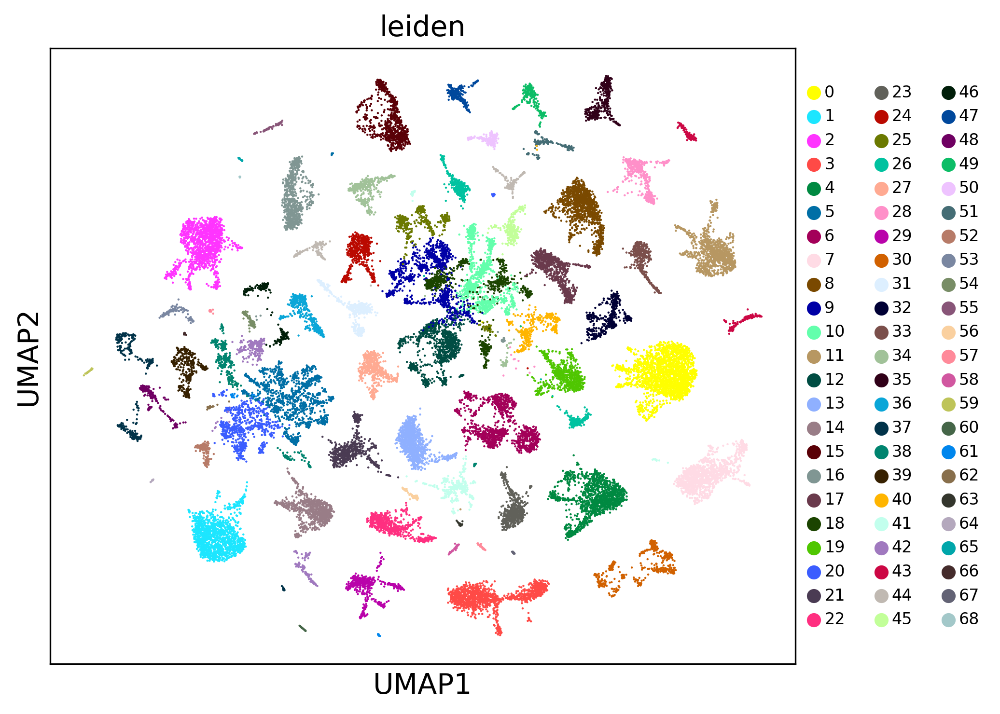

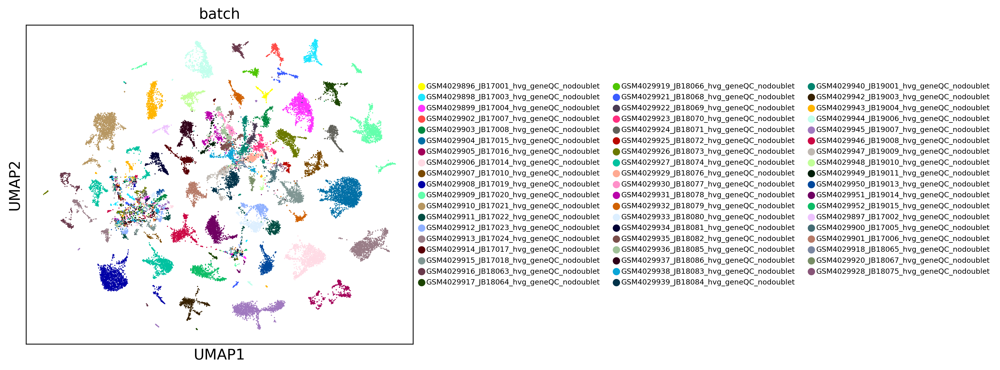

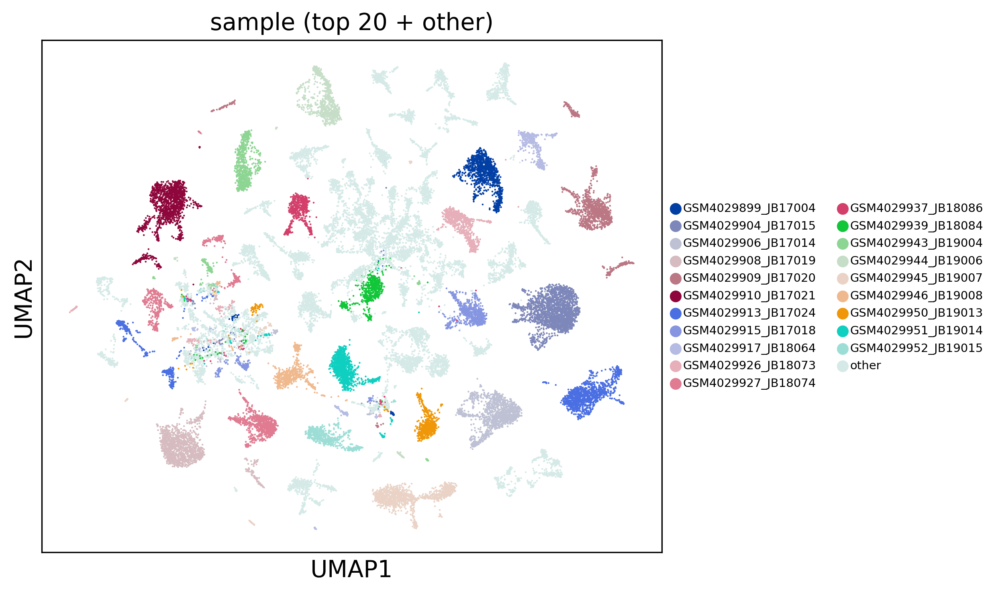

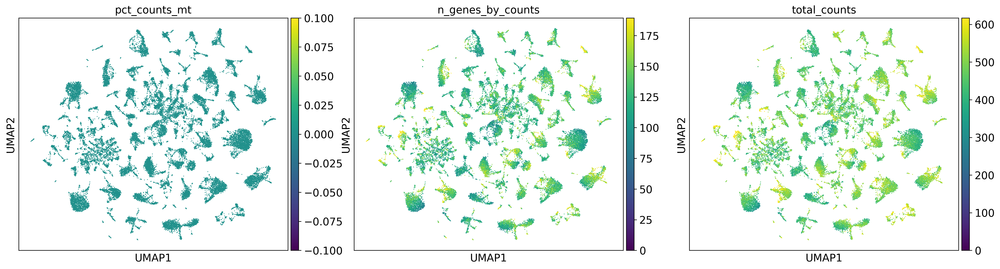

In [ ]:
# VISUALIZATION

import numpy as np
import scanpy as sc

# ---------- figure defaults ----------
sc.settings.set_figure_params(dpi=150, figsize=(6.6, 5.6), facecolor="white")
# Optional: save to Drive instead of inline
# sc.settings.figdir = "/content/drive/MyDrive/GSE135779/figs"

# ---------- prep: sample labels ----------
if "sample" in adata.obs:
    # shorten noisy suffixes if they exist
    adata.obs["sample_short"] = (
        adata.obs["sample"]
        .str.replace("_hvg_geneQC_nodoublet","", regex=False)
        .str.replace(".h5ad","", regex=False)
    )
else:
    adata.obs["sample_short"] = adata.obs.get("batch", "").astype(str)

# group rare samples into "other" for readable legend
N_TOP = 20
counts = adata.obs["sample_short"].value_counts()
keep = set(counts.index[:N_TOP])
adata.obs["sample_topN"] = np.where(adata.obs["sample_short"].isin(keep),
                                    adata.obs["sample_short"], "other")
adata.obs["sample_topN"] = adata.obs["sample_topN"].astype("category")

# ---------- helpers ----------
def umap_categorical(key, title=None, legend_fontsize=8, save_suffix=None):
    if key not in adata.obs:
        print(f"Skip: '{key}' not in .obs")
        return
    sc.pl.umap(
        adata,
        color=key,
        legend_loc="right margin",   # legend box instead of on-plot labels
        legend_fontsize=legend_fontsize,
        frameon=True,                # axes + UMAP1/UMAP2 labels
        title=title or key,
        size=4.5,
        # save=f"_{save_suffix}.png" if save_suffix else None  # uncomment to save
    )

def umap_continuous(keys, vmax="p99", vmin=None, cmap="viridis", ncols=3, save_suffix=None):
    keys = [k for k in keys if k in adata.obs]
    if not keys:
        print("No matching continuous keys found.")
        return
    sc.pl.umap(
        adata,
        color=keys,
        cmap=cmap,
        vmax=vmax,
        vmin=vmin,
        ncols=ncols,
        frameon=True,
        size=4.5,
        # save=f"_{save_suffix}.png" if save_suffix else None
    )

# ---------- plots ----------
# 1) Clusters with legend box + axes
umap_categorical("leiden", title="leiden", legend_fontsize=8, save_suffix="leiden")

# 2) Batch with legend box + axes
if "batch" in adata.obs:
    umap_categorical("batch", title="batch", legend_fontsize=7, save_suffix="batch")

# 3) Samples grouped to top-N + 'other' (clean legend)
umap_categorical("sample_topN", title=f"sample (top {N_TOP} + other)", legend_fontsize=7, save_suffix="sample_topN")

# 4) QC overlays (continuous) with axes
# clip negative mt percentages if any upstream transformation caused them
if "pct_counts_mt" in adata.obs:
    adata.obs["pct_counts_mt"] = adata.obs["pct_counts_mt"].clip(lower=0)

umap_continuous(
    ["pct_counts_mt", "n_genes_by_counts", "total_counts"],
    vmax="p99", vmin=0, cmap="viridis", ncols=3, save_suffix="qc"
)

# 5) (Optional) Export a color key mapping for 'leiden' and 'batch'
import pandas as pd
def export_color_key(obs_key, out_csv):
    cats = adata.obs[obs_key].cat.categories if obs_key in adata.obs and hasattr(adata.obs[obs_key], "cat") else None
    if cats is None:
        print(f"Skip color key: '{obs_key}' not categorical.")
        return
    # ensure palette exists
    sc.pl.umap(adata, color=obs_key, show=False)
    colors = adata.uns.get(f"{obs_key}_colors", [])
    pd.DataFrame({"category": cats, "color": colors}).to_csv(out_csv, index=False)
    print(f"Saved color key → {out_csv}")

# export_color_key("leiden", "/content/drive/MyDrive/GSE135779/analysis_out/leiden_color_key.csv")
# if "batch" in adata.obs:
#     export_color_key("batch", "/content/drive/MyDrive/GSE135779/analysis_out/batch_color_key.csv")


running Leiden clustering
    finished: found 55 clusters and added
    'leiden_0.2', the cluster labels (adata.obs, categorical) (0:00:13)
running Leiden clustering
    finished: found 65 clusters and added
    'leiden_0.4', the cluster labels (adata.obs, categorical) (0:00:11)
running Leiden clustering
    finished: found 74 clusters and added
    'leiden_0.6', the cluster labels (adata.obs, categorical) (0:00:11)
running Leiden clustering
    finished: found 81 clusters and added
    'leiden_0.8', the cluster labels (adata.obs, categorical) (0:00:18)
running Leiden clustering
    finished: found 86 clusters and added
    'leiden_1.0', the cluster labels (adata.obs, categorical) (0:00:14)


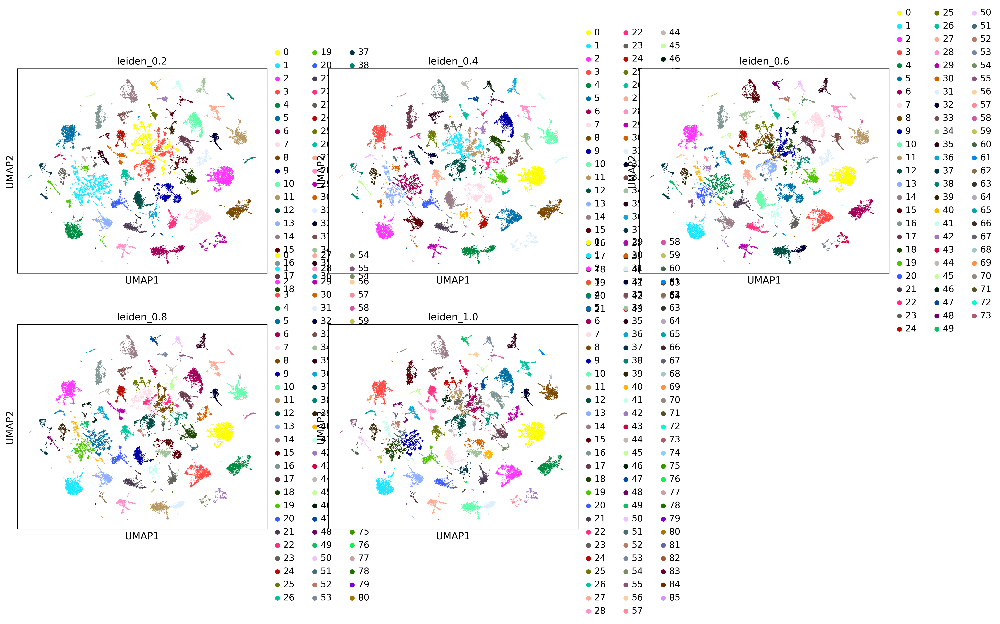

In [ ]:
import scanpy as sc

# compute multiple clusterings without redoing neighbors
for res in [0.2, 0.4, 0.6, 0.8, 1.0]:
    sc.tl.leiden(adata, resolution=res, key_added=f"leiden_{res}")

sc.pl.umap(adata, color=[f"leiden_{r}" for r in [0.2,0.4,0.6,0.8,1.0]],
           ncols=3, legend_loc="right margin", frameon=True)

# choose one and make it the working labels
adata.obs["leiden"] = adata.obs["leiden_0.6"].copy()   # <-- change 0.6 to your pick


In [ ]:
import os, time, numpy as np, pandas as pd
import scanpy as sc
from scipy.sparse import issparse

SEED = 42  # <— keep consistent for reproducibility
np.random.seed(SEED)
sc.settings.verbosity = 3
sc.settings.set_figure_params(dpi=150, facecolor="white")

HVG_PATH = "/content/drive/MyDrive/GSE135779/GSE135779_RAW/merged_outer_norm_hvg3000.h5ad"
OUT_DIR  = "/content/drive/MyDrive/GSE135779/GSE135779_RAW/analysis_out"
FIG_DIR  = "/content/drive/MyDrive/GSE135779/GSE135779_RAW/figs"
os.makedirs(OUT_DIR, exist_ok=True)
os.makedirs(FIG_DIR, exist_ok=True)

adata = sc.read_h5ad(HVG_PATH)
print("Loaded:", adata.shape)

# keep memory light
if issparse(adata.X): adata.X = adata.X.tocsr().astype("float32")
else:                 adata.X = adata.X.astype("float32")
adata.raw = None


Loaded: (35460, 3000)


computing PCA
    with n_comps=30
    finished (0:00:03)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:31)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:57)
running Leiden clustering


/tmp/ipython-input-2449912886.py:5: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution=0.5, key_added="leiden_r0_5", random_state=SEED)


    finished: found 71 clusters and added
    'leiden_r0_5', the cluster labels (adata.obs, categorical) (0:00:15)


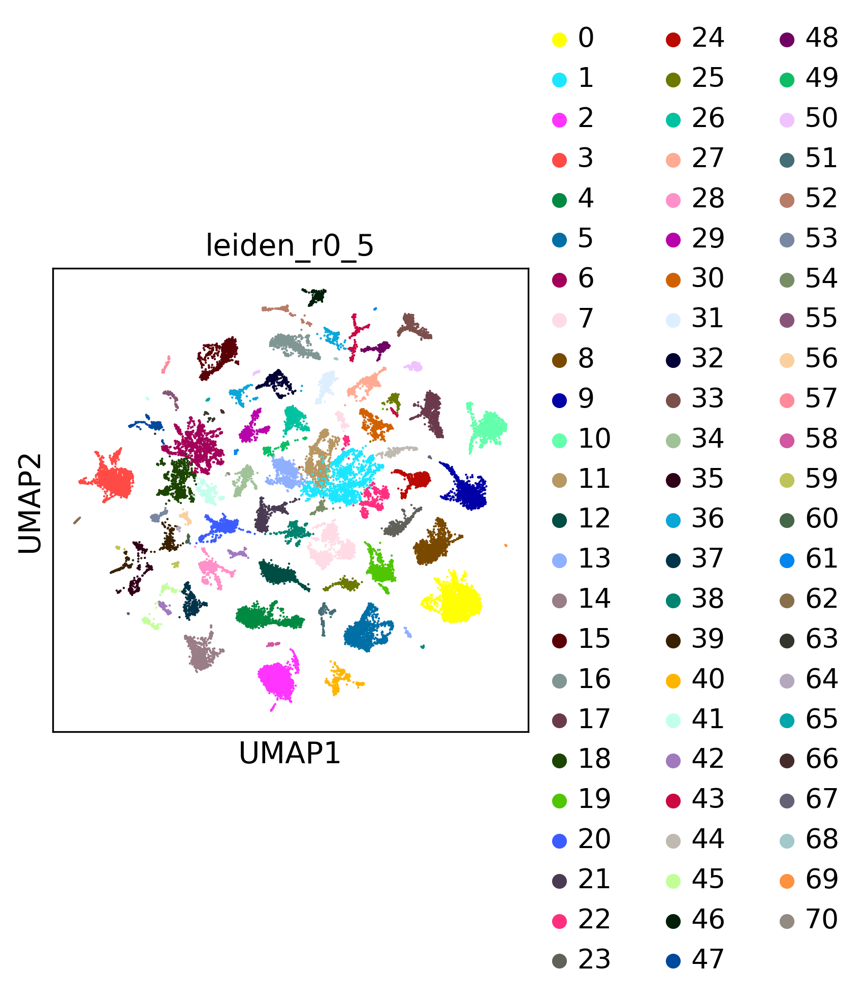

In [ ]:
# PCA (sparse-friendly) + neighbors + UMAP + Leiden with fixed seeds
sc.tl.pca(adata, n_comps=30, zero_center=False, svd_solver="arpack")
sc.pp.neighbors(adata, n_pcs=30, n_neighbors=10, method="umap", random_state=SEED)
sc.tl.umap(adata, min_dist=0.5, random_state=SEED)
sc.tl.leiden(adata, resolution=0.5, key_added="leiden_r0_5", random_state=SEED)

# Plot with axes + legend box
sc.pl.umap(
    adata, color="leiden_r0_5",
    legend_loc="right margin", frameon=True, size=4.5,
    save=False
)


Recomputing PCA with n_comps=50 (had 30)…
computing PCA
    with n_comps=50
    finished (0:00:10)
New PCA shape: (35460, 50)

=== UMAP variant 1: {'n_pcs': 30, 'n_neighbors': 10, 'min_dist': 0.5} ===
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:12)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:48)
running Leiden clustering
    finished: found 69 clusters and added
    'leiden_var1_r0_5', the cluster labels (adata.obs, categorical) (0:00:15)


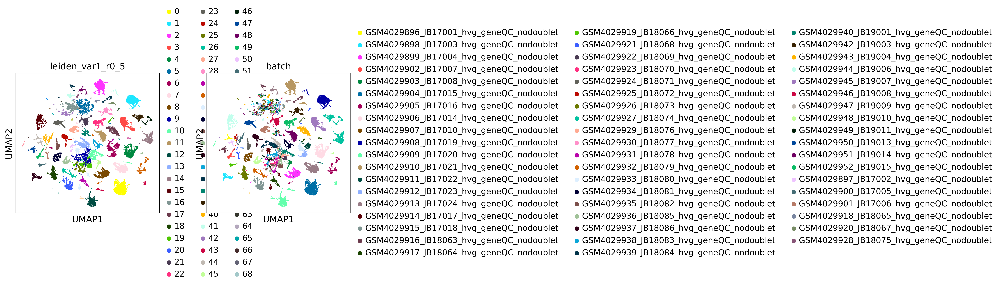


=== UMAP variant 2: {'n_pcs': 30, 'n_neighbors': 15, 'min_dist': 0.5} ===
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:08)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:59)
running Leiden clustering
    finished: found 61 clusters and added
    'leiden_var2_r0_5', the cluster labels (adata.obs, categorical) (0:00:20)


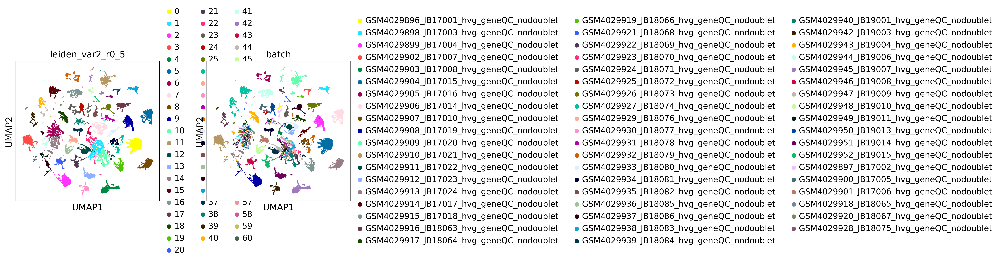


=== UMAP variant 3: {'n_pcs': 40, 'n_neighbors': 15, 'min_dist': 0.4} ===
computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:07)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:56)
running Leiden clustering
    finished: found 64 clusters and added
    'leiden_var3_r0_5', the cluster labels (adata.obs, categorical) (0:00:20)


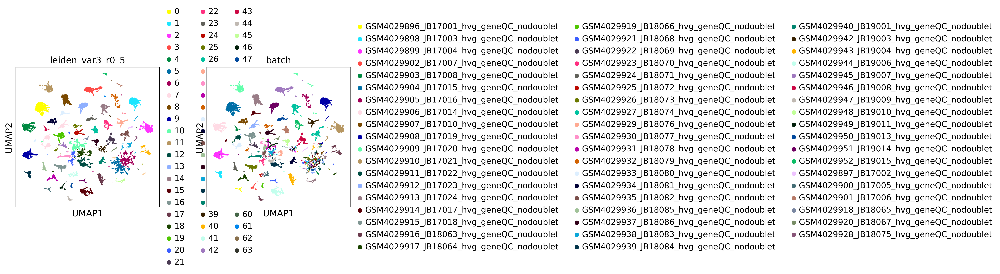


=== UMAP variant 4: {'n_pcs': 50, 'n_neighbors': 30, 'min_dist': 0.3} ===
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:14)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:01:03)
running Leiden clustering
    finished: found 58 clusters and added
    'leiden_var4_r0_5', the cluster labels (adata.obs, categorical) (0:00:24)


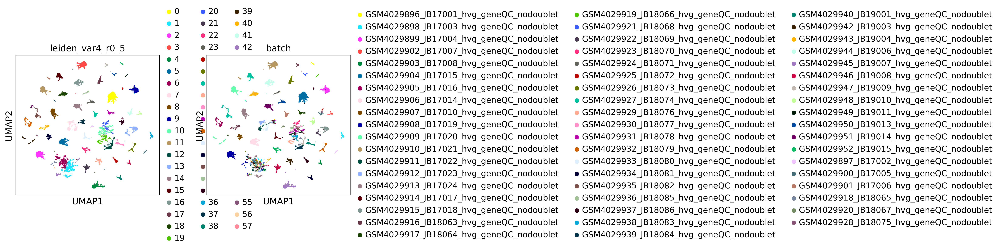

In [ ]:
import numpy as np, scanpy as sc
from scipy.sparse import issparse

SEED = 42
sc.settings.verbosity = 3

# your param grid (unchanged)
param_grid = [
    dict(n_pcs=30, n_neighbors=10, min_dist=0.5),
    dict(n_pcs=30, n_neighbors=15, min_dist=0.5),
    dict(n_pcs=40, n_neighbors=15, min_dist=0.4),
    dict(n_pcs=50, n_neighbors=30, min_dist=0.3),
]

# 1) Make sure PCA has enough components for the largest request
need_pcs = max(p["n_pcs"] for p in param_grid)
have_pcs = adata.obsm["X_pca"].shape[1] if "X_pca" in adata.obsm else 0

if have_pcs < need_pcs:
    print(f"Recomputing PCA with n_comps={need_pcs} (had {have_pcs})…")
    # keep memory light
    if issparse(adata.X): adata.X = adata.X.tocsr().astype("float32")
    else:                 adata.X = adata.X.astype("float32")
    adata.raw = None
    # zero_center=False → sparse-friendly TruncatedSVD path; seed for reproducibility
    sc.tl.pca(adata, n_comps=need_pcs, zero_center=False, random_state=SEED)
    print("New PCA shape:", adata.obsm["X_pca"].shape)
else:
    print(f"PCA already has {have_pcs} components — OK.")

# 2) Run your seeded UMAP variants
for i, p in enumerate(param_grid, 1):
    print(f"\n=== UMAP variant {i}: {p} ===")
    sc.pp.neighbors(
        adata,
        n_pcs=p["n_pcs"],
        n_neighbors=p["n_neighbors"],
        method="umap",
        random_state=SEED,   # reproducible kNN graph (pynndescent)
    )
    sc.tl.umap(adata, min_dist=p["min_dist"], random_state=SEED)
    sc.tl.leiden(adata, resolution=0.5, key_added=f"leiden_var{i}_r0_5", random_state=SEED)
    sc.pl.umap(
        adata,
        color=[f"leiden_var{i}_r0_5","batch"] if "batch" in adata.obs else [f"leiden_var{i}_r0_5"],
        legend_loc="right margin",
        frameon=True,
        ncols=2,
        size=4.5,
        # save=f"_umap_var{i}.png",  # uncomment if you want files saved
    )


In [ ]:
# Choose which cluster labels to use for markers (edit if you prefer another column)
CLUST_KEY = "leiden_r0_5"  # <-- change to your preferred cluster result
if CLUST_KEY not in adata.obs: raise ValueError(f"{CLUST_KEY} not found in .obs")

# Differential expression per cluster
sc.tl.rank_genes_groups(adata, groupby=CLUST_KEY, method="wilcoxon", tie_correct=True)

# Nice: dotplot of *ranked* genes (built-in), if your Scanpy supports it
try:
    sc.pl.rank_genes_groups_dotplot(
        adata, n_genes=5, values_to_plot="logfoldchanges",
        min_logfoldchange=0.25, dendrogram=False,
        color_map="viridis",  # continuous coloring
        standard_scale="var",
        save="_top5_per_cluster.png"
    )
except Exception:
    # Fallback: build a gene list and dotplot manually
    df = sc.get.rank_genes_groups_df(adata, None)
    top_by_cluster = (
        df.sort_values(["group","scores"], ascending=[True,False])
          .groupby("group").head(5)["names"].tolist()
    )
    sc.pl.dotplot(
        adata, var_names=top_by_cluster, groupby=CLUST_KEY,
        standard_scale="var", dendrogram=False,
        save="_top5_per_cluster_fallback.png"
    )

# Also save a full markers table
markers_df = sc.get.rank_genes_groups_df(adata, None)
markers_df.to_csv(os.path.join(OUT_DIR, f"markers_{CLUST_KEY}_wilcoxon.csv"), index=False)
print("Saved:", os.path.join(OUT_DIR, f"markers_{CLUST_KEY}_wilcoxon.csv"))


ranking genes


/usr/local/lib/python3.12/dist-packages/scanpy/tools/_rank_genes_groups.py:456: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/usr/local/lib/python3.12/dist-packages/scanpy/tools/_rank_genes_groups.py:458: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/usr/local/lib/python3.12/dist-packages/scanpy/tools/_rank_genes_groups.py:461: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result

    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:07:32)


Saved: /content/drive/MyDrive/GSE135779/GSE135779_RAW/analysis_out/markers_leiden_r0_5_wilcoxon.csv


In [ ]:
library(org.Hs.eg.db)
infile = read.csv("/content/drive/MyDrive/GSE135779/GSE135779_RAW/analysis_out/markers_leiden_r0_5_wilcoxon.csv") #replace with name of your file and its location (right click copy path on the file and past that here)
data = infile["ENSEMBL"]
data = as.vector(data)
annots <- select(org.Hs.eg.db, keys=data,columns="SYMBOL", keytype="ENSEMBL")
result <- merge(infile, annots, by.x="ENSEMBL", by.y="ENSEMBL")
print(head(result)) ## and then save it as a new csv file named something else.

SyntaxError: invalid syntax (ipython-input-1073145782.py, line 4)

In [ ]:
pip install mygene

In [ ]:
import pandas as pd
from mygene import MyGeneInfo

In [ ]:
infile = pd.read_csv("/content/drive/MyDrive/GSE135779/GSE135779_RAW/analysis_out/markers_leiden_r0_5_wilcoxon.csv")
print(infile.columns)
ensembl_ids = infile["names"].astype(str)
ensembl_ids = ensembl_ids.str.replace(r"\..*", "", regex=True)
mg = MyGeneInfo()

query_results = mg.querymany(
    ensembl_ids.tolist(),
    scopes="ensembl.gene",
    fields="symbol",
    species="human"
)

annots = pd.DataFrame(query_results)[["query", "symbol"]]
annots.rename(columns={"query": "names", "symbol": "SYMBOL"}, inplace=True)

result = infile.merge(annots, on="names", how="left")

print(result.head())

Index(['group', 'names', 'scores', 'logfoldchanges', 'pvals', 'pvals_adj'], dtype='object')


INFO:biothings.client:querying 1-1000 ...
INFO:biothings.client:querying 1001-2000 ...
INFO:biothings.client:querying 2001-3000 ...
INFO:biothings.client:querying 3001-4000 ...
INFO:biothings.client:querying 4001-5000 ...
INFO:biothings.client:querying 5001-6000 ...
INFO:biothings.client:querying 6001-7000 ...
INFO:biothings.client:querying 7001-8000 ...
INFO:biothings.client:querying 8001-9000 ...
INFO:biothings.client:querying 9001-10000 ...
INFO:biothings.client:querying 10001-11000 ...
INFO:biothings.client:querying 11001-12000 ...
INFO:biothings.client:querying 12001-13000 ...
INFO:biothings.client:querying 13001-14000 ...
INFO:biothings.client:querying 14001-15000 ...
INFO:biothings.client:querying 15001-16000 ...
INFO:biothings.client:querying 16001-17000 ...
INFO:biothings.client:querying 17001-18000 ...
INFO:biothings.client:querying 18001-19000 ...
INFO:biothings.client:querying 19001-20000 ...
INFO:biothings.client:querying 20001-21000 ...
INFO:biothings.client:querying 2100

   group            names  scores  logfoldchanges  pvals  pvals_adj SYMBOL
0      0  ENSG00000137575   75.64        4.594996    0.0        0.0  SDCBP
1      0  ENSG00000137575   75.64        4.594996    0.0        0.0  SDCBP
2      0  ENSG00000137575   75.64        4.594996    0.0        0.0  SDCBP
3      0  ENSG00000137575   75.64        4.594996    0.0        0.0  SDCBP
4      0  ENSG00000137575   75.64        4.594996    0.0        0.0  SDCBP


In [ ]:
infile = pd.read_csv("/content/drive/MyDrive/GSE135779/GSE135779_RAW/analysis_out/markers_leiden_r0_5_wilcoxon.csv")

In [ ]:
import pandas as pd
from pathlib import Path

# Load FULL markers file
in_path = Path(
    "/content/drive/MyDrive/GSE135779/analysis_out/juvenile_markers_leiden_bbknn_r0_8_full.csv"
)
df = pd.read_csv(in_path)

# Keep only relevant columns and rename
m = df[["group", "names", "scores"]].copy()
m.columns = ["cluster", "gene", "score"]

# If the same gene appears multiple times in a cluster, keep the highest score
m = m.sort_values(["gene", "cluster", "score"], ascending=[True, True, False])
m = m.drop_duplicates(subset=["gene", "cluster"], keep="first")

# Pivot:
# rows = genes
# columns = clusters
# values = score
gene_cluster_matrix = m.pivot(
    index="gene",
    columns="cluster",
    values="score"
)

# Optional: sort clusters numerically across the top
gene_cluster_matrix = gene_cluster_matrix.reindex(
    sorted(gene_cluster_matrix.columns, key=lambda x: int(x)),
    axis=1
)

# Optional: restrict to clusters 1–9 (change to 0–9 if needed)
gene_cluster_matrix = gene_cluster_matrix.loc[:, [c for c in gene_cluster_matrix.columns if 1 <= int(c) <= 9]]

# Save
out_path = Path(
    "/content/drive/MyDrive/GSE135779/analysis_out/juvenile_gene_by_cluster_scores.csv"
)
gene_cluster_matrix.to_csv(out_path)

print("Saved:", out_path)
print("Shape (genes x clusters):", gene_cluster_matrix.shape)
gene_cluster_matrix.head()


Saved: /content/drive/MyDrive/GSE135779/analysis_out/juvenile_gene_by_cluster_scores.csv
Shape (genes x clusters): (3000, 9)


cluster,1,2,3,4,5,6,7,8,9
gene,,,,,,,,,
ENSG00000000938,23.307062,34.815285,8.782627,-26.223188,-17.837770,-26.324554,-9.934341,-8.271214,-16.850277
ENSG00000001561,-2.115453,-0.824090,-0.292612,7.450695,1.016205,7.826899,0.515964,-1.077759,5.605906
ENSG00000002586,0.301764,-20.259987,9.359552,28.290846,8.344094,15.151317,1.265553,-2.032392,6.806487
ENSG00000002587,-5.045939,-0.307476,2.880345,-2.121306,12.690875,0.189995,-1.166978,-0.087694,16.499235
ENSG00000002933,19.655460,-1.615790,-7.383075,-22.157410,-15.506440,-11.020476,0.552873,-2.926098,-7.259312


In [ ]:
import pandas as pd
from pathlib import Path

in_path = Path(
    "/content/drive/MyDrive/GSE135779/analysis_out/juvenile_markers_leiden_bbknn_r0_8_full.csv"
)
df = pd.read_csv(in_path)

# Keep relevant columns
m = df[["group", "names", "scores"]].copy()
m.columns = ["cluster", "gene", "score"]

# Deduplicate (keep highest score per gene per cluster)
m = m.sort_values(["gene", "cluster", "score"], ascending=[True, True, False])
m = m.drop_duplicates(subset=["gene", "cluster"], keep="first")

# Pivot: genes (rows) × clusters (columns)
gene_cluster_matrix = m.pivot(
    index="gene",
    columns="cluster",
    values="score"
)

# Sort clusters numerically (this keeps 0!)
gene_cluster_matrix = gene_cluster_matrix.reindex(
    sorted(gene_cluster_matrix.columns, key=lambda x: int(x)),
    axis=1
)

# Save
out_path = Path(
    "/content/drive/MyDrive/GSE135779/analysis_out/juvenile_gene_by_cluster_scores.csv"
)
gene_cluster_matrix.to_csv(out_path)

print("Saved:", out_path)
print("Clusters:", gene_cluster_matrix.columns.tolist())
print("Shape:", gene_cluster_matrix.shape)
gene_cluster_matrix.head()


Saved: /content/drive/MyDrive/GSE135779/analysis_out/juvenile_gene_by_cluster_scores.csv
Clusters: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Shape: (3000, 10)


cluster,0,1,2,3,4,5,6,7,8,9
gene,,,,,,,,,,
ENSG00000000938,-11.551851,23.307062,34.815285,8.782627,-26.223188,-17.837770,-26.324554,-9.934341,-8.271214,-16.850277
ENSG00000001561,-6.569533,-2.115453,-0.824090,-0.292612,7.450695,1.016205,7.826899,0.515964,-1.077759,5.605906
ENSG00000002586,-20.031994,0.301764,-20.259987,9.359552,28.290846,8.344094,15.151317,1.265553,-2.032392,6.806487
ENSG00000002587,-4.920425,-5.045939,-0.307476,2.880345,-2.121306,12.690875,0.189995,-1.166978,-0.087694,16.499235
ENSG00000002933,15.416324,19.655460,-1.615790,-7.383075,-22.157410,-15.506440,-11.020476,0.552873,-2.926098,-7.259312


In [ ]:
gene_cluster_matrix_plus100 = gene_cluster_matrix + 100


In [ ]:
out_path = "/content/drive/MyDrive/GSE135779/analysis_out/juvenile_gene_by_cluster_scores_plus100.csv"
gene_cluster_matrix_plus100.to_csv(out_path)
out_path


'/content/drive/MyDrive/GSE135779/analysis_out/juvenile_gene_by_cluster_scores_plus100.csv'